In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# a nice way of filtering out deprecated warnings
import warnings
warnings.filterwarnings("ignore")
#df = pd.read_csv("/Users/zhangming/ADS/yellow_tripdata_2018-08.csv")

In [3]:
df_1=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2018-05.csv")
df_2=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2018-06.csv")
df_3=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2018-07.csv")
df_4=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2018-08.csv")
df_5=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2018-09.csv")
df_6=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2018-03.csv")
df_7=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2018-04.csv")

In [4]:
df=pd.concat([df_1,df_2,df_3,df_4,df_5,df_6,df_7],ignore_index=True)

In [7]:
df.dtypes.to_csv('table/table_3.csv')

In [8]:
print(df.tail())
#df.describe(include='all')


          VendorID tpep_pickup_datetime tpep_dropoff_datetime  \
60412795         1  2018-04-30 23:15:20   2018-04-30 23:32:58   
60412796         2  2018-04-30 23:02:02   2018-04-30 23:03:37   
60412797         2  2018-04-30 23:38:18   2018-04-30 23:44:57   
60412798         2  2018-04-30 23:07:08   2018-04-30 23:23:04   
60412799         2  2018-04-30 23:26:50   2018-04-30 23:44:54   

          passenger_count  trip_distance  RatecodeID store_and_fwd_flag  \
60412795                1           3.60           1                  N   
60412796                5           0.01           1                  N   
60412797                1           1.62           1                  N   
60412798                1           6.36           1                  N   
60412799                1           7.17           1                  N   

          PULocationID  DOLocationID  payment_type  fare_amount  extra  \
60412795           148           112             1         14.5    0.5   
60412796  

In [5]:
#add the service time to the dataframe
from datetime import datetime

def finddiff(str1,str2):
    try: 
        date1=datetime.fromisoformat(str1)
        date2=datetime.fromisoformat(str2)   
        time_diff=(date2-date1).total_seconds()
    except ValueError:
        print(str1)
        
    return time_diff
df['time_diff'] = df.apply(lambda x: finddiff(x.tpep_pickup_datetime, x.tpep_dropoff_datetime), axis=1)
#df['time_diff']=df[['tpep_pickup_datetime','tpep_dropoff_datetime']].apply(lambda x,y: finddiff(x,y))

In [6]:
df_1=df.drop(df[((df['payment_type']!=1)|(df['tip_amount']<=0.00))].index)

In [16]:
table_1=df_1['tip_amount'].describe()
table_1.to_csv('table/table_1.csv')

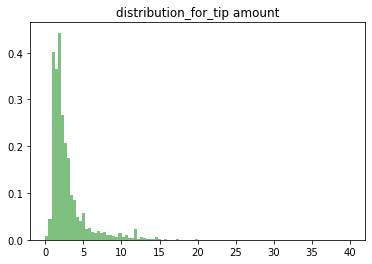

In [12]:
plt.hist(df_1[df_1['tip_amount']<=40]["tip_amount"], alpha=0.5, bins=100, color='g',density=True)
plt.title('distribution_for_tip amount')
plt.savefig('plot/distribution_for_tip amount.png')

In [11]:
#divide time to bin (pickup time and dropped off time) one hour for one bin 

df_2=df_1 
df_2['ptime_str']=df_1['tpep_pickup_datetime'].apply(lambda x: str(x[11:13]))
df_2['dtime_str']=df_1['tpep_dropoff_datetime'].apply(lambda x: str(x[11:13]))
                                                      
                                                      

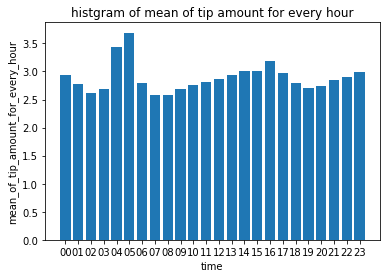

In [25]:
#plot a hist plot between the mean for every time mean and bin number
pgrouped_df = df_2[['ptime_str', 'tip_amount']].groupby("ptime_str")
pmean_df = pgrouped_df.mean()
pmean_df = pmean_df.reset_index()

x = pmean_df['ptime_str']
pmean_df.rename(columns={'tip_amount':'ptip_amount'}, inplace=True)
plt.bar(x, height=pmean_df['ptip_amount'])
plt.xlabel('time')
plt.ylabel('mean_of_tip_amount_for_every_hour')
plt.title('histgram of mean of tip amount for every hour')
plt.savefig('plot/figure_1.png')

<BarContainer object of 24 artists>

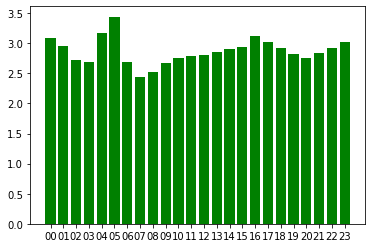

In [16]:
#plot a hist plot between the mean for every time mean and bin number
dgrouped_df = df_2[['dtime_str', 'tip_amount']].groupby("dtime_str")
dmean_df = dgrouped_df.mean()
dmean_df = dmean_df.reset_index()

x = dmean_df['dtime_str']
dmean_df.rename(columns={'tip_amount':'dtip_amount'}, inplace=True)
plt.bar(x, height=dmean_df['dtip_amount'],color='green')


   dtime_str  dtip_amount  ptip_amount
0         00     3.096763     2.939821
1         01     2.960996     2.768393
2         02     2.728160     2.618163
3         03     2.697340     2.695544
4         04     3.177573     3.427625
5         05     3.442581     3.690481
6         06     2.697674     2.792682
7         07     2.442513     2.583685
8         08     2.522272     2.588289
9         09     2.672928     2.693269
10        10     2.756630     2.751154
11        11     2.790919     2.807762
12        12     2.801310     2.859208
13        13     2.858378     2.929233
14        14     2.901698     3.008539
15        15     2.945711     3.007585
16        16     3.117329     3.184911
17        17     3.025071     2.977475
18        18     2.914179     2.796579
19        19     2.820731     2.709659
20        20     2.751286     2.741692
21        21     2.834025     2.850446
22        22     2.917520     2.899252
23        23     3.029922     2.986461


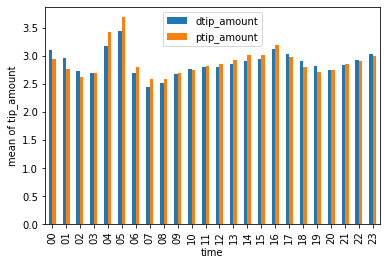

In [18]:
#plot a hist plot between the mean for every time mean and bin number
combine_df=dmean_df.merge(pmean_df,left_on='dtime_str',right_on='ptime_str')
combine_df=combine_df.drop(['ptime_str'], axis=1)
print(combine_df)
combine_df.plot(x="dtime_str", y=["dtip_amount", "ptip_amount"], kind="bar",xlabel='time', ylabel='mean of tip_amount')
plt.savefig('plot/figure_2.png')

In [19]:
from datetime import datetime
#2018-08-31 23:54:46
def week(string):
    week=datetime.strptime(string,"%Y-%m-%d").weekday()
    return week
df_2['pweek_str']=df_1['tpep_pickup_datetime'].apply(lambda x: week(str(x[0:10])))
df_2['dweek_str']=df_1['tpep_dropoff_datetime'].apply(lambda x: week(str(x[0:10])))


   dtime_str  dtip_amount  ptip_amount
0         00     3.096763     2.939821
1         01     2.960996     2.768393
2         02     2.728160     2.618163
3         03     2.697340     2.695544
4         04     3.177573     3.427625
5         05     3.442581     3.690481
6         06     2.697674     2.792682
7         07     2.442513     2.583685
8         08     2.522272     2.588289
9         09     2.672928     2.693269
10        10     2.756630     2.751154
11        11     2.790919     2.807762
12        12     2.801310     2.859208
13        13     2.858378     2.929233
14        14     2.901698     3.008539
15        15     2.945711     3.007585
16        16     3.117329     3.184911
17        17     3.025071     2.977475
18        18     2.914179     2.796579
19        19     2.820731     2.709659
20        20     2.751286     2.741692
21        21     2.834025     2.850446
22        22     2.917520     2.899252
23        23     3.029922     2.986461


<AxesSubplot:xlabel='week', ylabel='mean of tip_amount'>

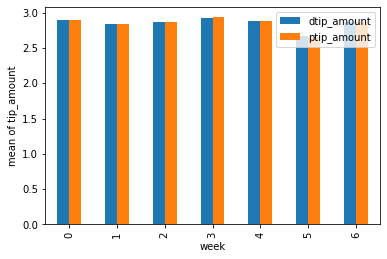

In [20]:
pgrouped_df_w = df_2[['pweek_str', 'tip_amount']].groupby("pweek_str")
pmean_df_w = pgrouped_df_w.mean()
pmean_df_w = pmean_df_w.reset_index()

x = pmean_df_w['pweek_str']
pmean_df_w.rename(columns={'tip_amount':'ptip_amount'}, inplace=True)


dgrouped_df_w = df_2[['dweek_str', 'tip_amount']].groupby("dweek_str")
dmean_df_w = dgrouped_df_w.mean()
dmean_df_w = dmean_df_w.reset_index()

x = dmean_df_w['dweek_str']
dmean_df_w.rename(columns={'tip_amount':'dtip_amount'}, inplace=True)


combine_df_w=dmean_df_w.merge(pmean_df_w,left_on='dweek_str',right_on='pweek_str')
combine_df_w=combine_df_w.drop(['pweek_str'], axis=1)
print(combine_df)
combine_df_w.plot(x="dweek_str", y=["dtip_amount", "ptip_amount"], kind="bar",xlabel='week', ylabel='mean of tip_amount')


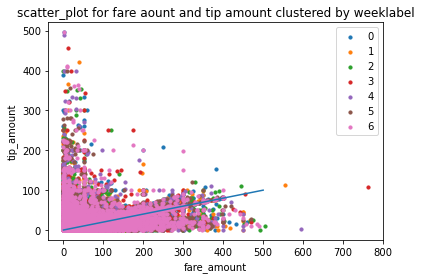

In [23]:
import numpy as np
fig, ax = plt.subplots()
scatter_x = np.array(df_2['fare_amount'])
scatter_y = np.array(df_2['tip_amount'])
group = np.array(df_2['dweek_str'])
for g in np.unique(group):
    i = np.where(group == g)
    ax.scatter(scatter_x[i], scatter_y[i], label=g,s=10)

X = np.linspace(0, 500, 500)
Y = np.linspace(0, 100, 500)
ax.plot(X, Y)
ax.legend()
plt.xlabel('fare_amount')
plt.ylabel('tip_amount')
plt.title('scatter_plot for fare aount and tip amount clustered by weeklabel')
plt.savefig('plot/figure_3.png')
plt.show()

In [28]:
#rate code ID and tip count
df_r2=df_2.drop(df_2[(df_2['RatecodeID']>6)|(df_2['tip_amount']>50)].index)
rgrouped_df = df_r2[['RatecodeID', 'tip_amount']].groupby("RatecodeID")
print(rgrouped_df.size())
rmean_df = rgrouped_df.median()
rmean_df = rmean_df.reset_index()


RatecodeID
1    38458613
2      987469
3       84976
4       21611
5      119020
6          37
dtype: int64


<Figure size 432x288 with 0 Axes>

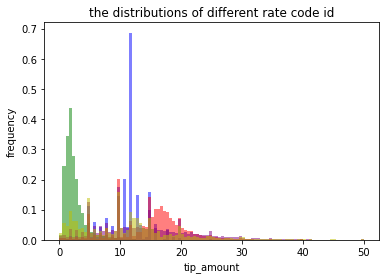

In [30]:
plt.hist(df_r2[df_r2['RatecodeID']==1]["tip_amount"], alpha=0.5, bins=100, color='g', label='1',density=True)
plt.hist(df_r2[df_r2['RatecodeID']==2]["tip_amount"], alpha=0.5, bins=100, color='b', label='2',density=True)
plt.hist(df_r2[df_r2['RatecodeID']==3]["tip_amount"], alpha=0.5, bins=100, color='r', label='3',density=True)
plt.hist(df_r2[df_r2['RatecodeID']==4]["tip_amount"], alpha=0.5, bins=100, color='purple', label='4',density=True)
plt.hist(df_r2[df_r2['RatecodeID']==5]["tip_amount"], alpha=0.5, bins=100, color='y', label='5',density=True)
plt.xlabel('tip_amount')
plt.ylabel('frequency')
plt.title('the distributions of different rate code id')
plt.savefig('plot/figure_4.png')
# there is a relationship between ratecodeID and tip amount use this feature in our model

In [31]:
#rate store_and_fwd_flag and tip count
def booltoint(char):
    var=0
    if char=='N':
        var=0
    else:
        var=1
    return var

df_2['store_and_fwd_flag']=df_2['store_and_fwd_flag'].apply(lambda x: booltoint(x))

In [34]:
df_s2=df_2.drop(df_2[(df_2['tip_amount']>20)].index)
sgrouped_df = df_s2[['store_and_fwd_flag', 'tip_amount']].groupby("store_and_fwd_flag")
print(sgrouped_df.size())


store_and_fwd_flag
0    39474712
1      149885
dtype: int64


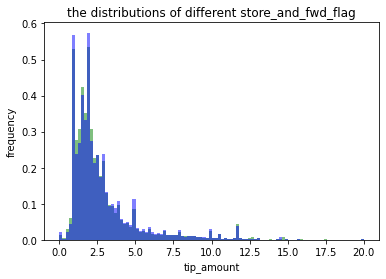

In [35]:
plt.hist(df_s2[df_s2['store_and_fwd_flag']==0]["tip_amount"], alpha=0.5, bins=100, color='g', label='0',density=True)
plt.hist(df_s2[df_s2['store_and_fwd_flag']==1]["tip_amount"], alpha=0.5, bins=100, color='b', label='1',density=True)
plt.xlabel('tip_amount')
plt.ylabel('frequency')
plt.title('the distributions of different store_and_fwd_flag')
plt.savefig('plot/figure_5.png')
#nearly the same don't need to include in our model

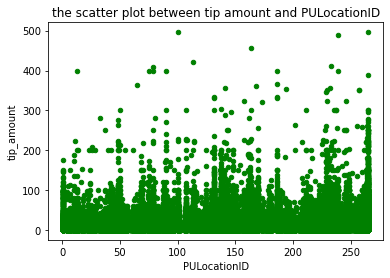

In [36]:
df_2[['PULocationID', 'tip_amount']].plot.scatter(x='PULocationID',
                                                  y='tip_amount',color="green")
plt.title('the scatter plot between tip amount and PULocationID')
plt.savefig('plot/figure_6.png')
plt.show()

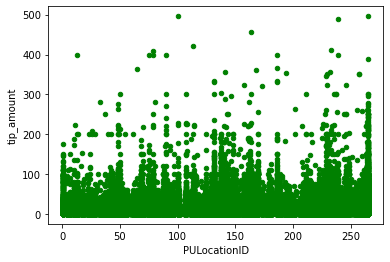

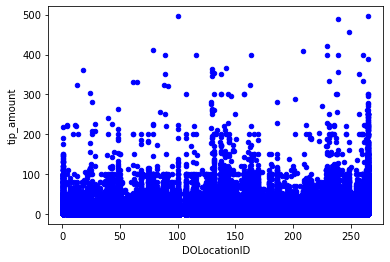

In [37]:
df_2[['PULocationID', 'tip_amount']].plot.scatter(x='PULocationID',
                                                  y='tip_amount',color="green")
df_2[['DOLocationID', 'tip_amount']].plot.scatter(x='DOLocationID',
                                                  y='tip_amount',color="blue")

plt.show()

VendorID
1    2044671
2    2984383
4      14444
dtype: int64


(array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21,
        0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31, 0.32,
        0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43,
        0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54,
        0.55, 0.56, 0.57, 0.58, 0.59, 0.6 , 0.61, 0.62, 0.63, 0.

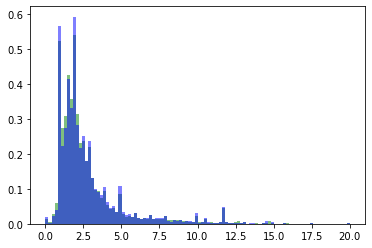

In [169]:
df_v2=df_2.drop(df_2[(df_2['tip_amount']>20)].index)
vgrouped_df = df_r2[['VendorID', 'tip_amount']].groupby("VendorID")
print(vgrouped_df.size())
plt.hist(df_v2[df_v2['store_and_fwd_flag']==0]["tip_amount"], alpha=0.5, bins=100, color='g', label='0',density=True)
plt.hist(df_v2[df_v2['store_and_fwd_flag']==1]["tip_amount"], alpha=0.5, bins=100, color='b', label='1',density=True)
plt.hist(df_v2[df_v2['store_and_fwd_flag']==4]["tip_amount"], alpha=0.5, bins=100, color='r', label='4',density=True)
#nearly the same don't need to include in our model

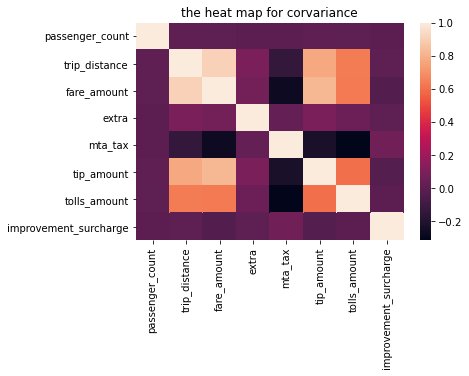

passenger_count          0.010178
trip_distance            0.769129
fare_amount              0.823453
extra                    0.091849
mta_tax                 -0.224851
tip_amount               1.000000
tolls_amount             0.600658
improvement_surcharge   -0.024280
Name: tip_amount, dtype: float64

In [18]:
#find the corvariance with all other continuous features
df_c2=df_1.drop(['VendorID','tpep_pickup_datetime','tpep_dropoff_datetime','RatecodeID','store_and_fwd_flag','PULocationID','DOLocationID','payment_type','total_amount'],axis=1)
df_c2=df_c2.dropna()
df_c2[df_c2<0]=0
sns.heatmap(df_c2.corr())
plt.title('the heat map for corvariance')
plt.savefig('plot/figure_7.png')
plt.show()
df_c2.corr()['tip_amount']

In [20]:
df_c2.corr()['tip_amount'].to_csv('table/table_2.csv')


In [8]:
#finally we could choose the best feature to predict the tip amount
df_p=df.drop(df[((df['payment_type']!=1)|(df['tip_amount']<=0.00))].index)
df_c=df_p[['trip_distance','fare_amount','tolls_amount','tip_amount']]
df_c['ptime_str']=df_p['tpep_pickup_datetime'].apply(lambda x: str(x[11:13]))
df_c['dtime_str']=df_p['tpep_dropoff_datetime'].apply(lambda x: str(x[11:13]))
df_c['PULocationID']=df_p['PULocationID'].map(str)
df_c['DOLocationID']=df_p['DOLocationID'].map(str)
df_c['RatecodeID']=df_p['RatecodeID'].map(str)
df_c['time_diff']=df_p['time_diff']


In [9]:
#clear this new dataset
df_c=df_c.dropna()
X=df_c.drop(['tip_amount','time_diff'],axis=1)
y=df_c['tip_amount']


In [9]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
#print(X_train)

In [10]:
#decision tree
from sklearn import tree
from sklearn.model_selection import GridSearchCV
clf_d = tree.DecisionTreeRegressor(max_depth=6)
clf_d.fit(X=X_train, y=y_train)
d_score=clf_d.score(X_test, y_test)
d_score

0.7110429569997407

In [11]:
from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(X_train, y_train)
l_score=reg.score(X_test, y_test)
l_score

0.6944811834913847

In [18]:
df_8=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2019-08.csv")
df_9=pd.read_csv("/Users/zhangming/ADS/raw_data/data/yellow_tripdata_2019-09.csv")

In [11]:
from sklearn import tree
clf_d = tree.DecisionTreeRegressor(max_depth=6)
clf_d.fit(X,y)


DecisionTreeRegressor(max_depth=6)

In [25]:
df_test=pd.concat([df_8,df_9],ignore_index=True)
df_test.dropna()
df_test=df_test.drop(df_test[((df_test['payment_type']!=1)|(df_test['tip_amount']<=0.00))].index)
df_t=df_test[['trip_distance','fare_amount','tolls_amount','tip_amount']]
df_t['ptime_str']=df_test['tpep_pickup_datetime'].apply(lambda x: str(x[11:13]))
df_t['dtime_str']=df_test['tpep_dropoff_datetime'].apply(lambda x: str(x[11:13]))
df_t['PULocationID']=df_test['PULocationID'].map(str)
df_t['DOLocationID']=df_test['DOLocationID'].map(str)
df_t['RatecodeID']=df_test['RatecodeID'].map(str)

In [29]:
X_test_all=df_t.drop(['tip_amount'],axis=1)
#X_test_all.dropna()
#y_pre=clf_d.predict(X_test_all)
clf_d.score(X_test_all, df_t['tip_amount'])

0.6211060402646222

In [12]:
df_p2=df.drop(df[(df['tip_amount']!=0)].index)
df_u=df_p2[['trip_distance','fare_amount','tolls_amount','tip_amount']]
df_u['ptime_str']=df_p2['tpep_pickup_datetime'].apply(lambda x: str(x[11:13]))
df_u['dtime_str']=df_p2['tpep_dropoff_datetime'].apply(lambda x: str(x[11:13]))
df_u['PULocationID']=df_p2['PULocationID'].map(str)
df_u['DOLocationID']=df_p2['DOLocationID'].map(str)
df_u['RatecodeID']=df_p2['RatecodeID'].map(str)
df_u['time_diff']=df_p2['time_diff']


In [13]:
#predict tip amount
X_test_all=df_u.drop(['tip_amount','time_diff'],axis=1)

df_u['tip_amount']=clf_d.predict(X_test_all)

In [14]:
df_all=pd.concat([df_c, df_u], ignore_index=True)
df_all

,trip_distance,fare_amount,tolls_amount,tip_amount,ptime_str,dtime_str,PULocationID,DOLocationID,RatecodeID,time_diff
0,1.60,8.0,0.0,1.850000,00,00,230,50,1,530.0
1,1.70,7.5,0.0,2.000000,00,00,263,239,1,390.0
2,2.60,12.0,0.0,1.000000,00,00,239,152,1,723.0
3,0.00,2.5,0.0,9.630000,00,00,145,145,1,53.0
4,3.30,12.5,0.0,2.750000,00,00,114,229,1,824.0
...,...,...,...,...,...,...,...,...,...,...
60411579,1.68,8.5,0.0,1.961511,23,23,113,170,1,489.0
60411580,0.60,4.5,0.0,1.288635,23,23,162,164,1,228.0
60411581,0.30,3.5,0.0,1.288635,23,23,90,186,1,106.0
60411582,0.01,3.0,0.0,1.288635,23,23,151,151,1,95.0


In [1]:
def car(f,t,diff):
    return (f+t)/(diff/3600)
df_all=df_all.drop(df_all[(df_all['time_diff']<=0)].index)
df_all['amount_per_hour']=df_all.apply(lambda x: car(x.fare_amount, x.tip_amount,x.time_diff), axis=1)


NameError: name 'df_all' is not defined

In [292]:
df_all

,trip_distance,fare_amount,tolls_amount,tip_amount,ptime_str,dtime_str,PULocationID,DOLocationID,RatecodeID,time_diff,amount_per_hour
0,5.60,19.0,0.00,4.000000,00,01,238,79,1,1127.0,73.469388
1,2.90,11.5,0.00,2.550000,00,00,138,7,1,675.0,74.933333
2,8.40,30.0,0.00,7.800000,00,00,231,7,1,2313.0,58.832685
3,6.70,25.5,0.00,4.020000,00,00,114,7,1,1952.0,54.442623
4,16.80,52.0,5.76,14.600000,00,01,132,162,2,1748.0,137.162471
...,...,...,...,...,...,...,...,...,...,...,...
7848986,0.48,4.0,0.00,1.295134,23,23,238,238,1,189.0,100.859705
7848987,3.35,12.0,0.00,2.528455,23,23,75,137,1,659.0,79.366368
7848988,1.30,7.5,0.00,1.658704,23,00,148,79,1,590.0,55.883617
7848989,1.37,7.5,0.00,1.658704,23,23,113,231,1,504.0,65.419313


In [293]:
import geopandas as gpd

# sf stands for shape file
sf = gpd.read_file("/Users/zhangming/ADS/taxi_zones/taxi_zones.shp")
zone = pd.read_csv("/Users/zhangming/ADS/taxi+_zone_lookup.csv")

# Convert the geometry shaape to to latitude and longitude
# Please attribute this if you are using it
sf['geometry'] = sf['geometry'].to_crs("+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")

In [296]:
df_all['PULocationID']=df_all['PULocationID'].apply(lambda x: int(x))
gdf = gpd.GeoDataFrame(pd.merge(df_all, sf, left_on='PULocationID', right_on='LocationID')).drop('PULocationID',axis=1)
gdf.sample(2)

,trip_distance,fare_amount,tolls_amount,tip_amount,ptime_str,dtime_str,DOLocationID,RatecodeID,time_diff,amount_per_hour,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
3144378,1.30,7.0,0.0,1.658704,19,19,166,1,402.0,77.540631,151,0.054890,0.000129,Manhattan Valley,151,Manhattan,"POLYGON ((-73.96371 40.79301, -73.96418 40.792..."
4091642,3.08,12.0,0.0,1.000000,22,22,141,1,736.0,63.586957,50,0.055748,0.000173,Clinton West,50,Manhattan,"POLYGON ((-73.99668 40.77351, -73.99434 40.772..."


In [298]:
geoJSON = gdf[['LocationID','geometry']].drop_duplicates('LocationID').to_json()

In [299]:
import folium
m = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on how to plot aggregated data.
m.add_child(folium.Choropleth(
    geo_data=geoJSON,
    name='choropleth',
))

m.save('../foliumChoroplethMap.html')
m

In [300]:
import json

# an example of what the geoJSON looks like
json.loads(geoJSON)

{'type': 'FeatureCollection',
 'features': [{'id': '0',
   'type': 'Feature',
   'properties': {'LocationID': 238},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-73.96884378999985, 40.78596738900014],
      [-73.96933573299991, 40.785293280000104],
      [-73.97217414999986, 40.78648646100012],
      [-73.97501417199996, 40.78768560600006],
      [-73.97639149199995, 40.78826674700012],
      [-73.97650149399988, 40.78831267700016],
      [-73.97660504199992, 40.78835448100009],
      [-73.97785649899998, 40.78888153900014],
      [-73.98035659399986, 40.789940558000154],
      [-73.98097150799998, 40.7901608780001],
      [-73.9815945909999, 40.790384124000134],
      [-73.98169328900003, 40.79041872800017],
      [-73.98176573099992, 40.790455426000094],
      [-73.98185980499981, 40.79050307800005],
      [-73.98188645923244, 40.79051658046771],
      [-73.98139174468552, 40.79122824600533],
      [-73.98128937370942, 40.79137550943319],
      [-73.9809470835407, 40.7918

In [305]:
gdf[['LocationID','amount_per_hour']].groupby('LocationID').sum().reset_index()

,LocationID,amount_per_hour
0,1,2.169382e+07
1,2,1.205080e+03
2,3,9.371980e+04
3,4,2.411148e+06
4,5,1.341023e+04
...,...,...
250,259,4.233750e+05
251,260,2.136481e+06
252,261,7.374747e+06
253,262,9.555221e+06


In [314]:
m_trip_distance = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on more information on how to plot aggregated data.
folium.Choropleth(
    geo_data=geoJSON, # geoJSON 
    name='choropleth', # name of plot
    data=gdf, # data source
    columns=['LocationID','tip_amount'], # the columns required
    key_on='properties.LocationID', # this is from the geoJSON's properties
    fill_color="YlGn", # color scheme
    fill_opacity=1,
    line_opacity=0.5,
    legend_name='Trips' # legend title
).add_to(m_trip_distance)

m_trip_distance.save('../foliumChoroplethMapTrips.html')
m_trip_distance

In [313]:
m_trip_distance = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on more information on how to plot aggregated data.
folium.Choropleth(
    geo_data=geoJSON, # geoJSON 
    name='choropleth', # name of plot
    data=gdf, # data source
    columns=['LocationID','fare_amount'], # the columns required
    key_on='properties.LocationID', # this is from the geoJSON's properties
    fill_color="YlGn", # color scheme
    fill_opacity=1,
    line_opacity=0.5,
    legend_name='Trips' # legend title
).add_to(m_trip_distance)

m_trip_distance.save('../foliumChoroplethMapTrips.html')
m_trip_distance

In [315]:
m_trip_distance = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on more information on how to plot aggregated data.
folium.Choropleth(
    geo_data=geoJSON, # geoJSON 
    name='choropleth', # name of plot
    data=gdf, # data source
    columns=['LocationID','amount_per_hour'], # the columns required
    key_on='properties.LocationID', # this is from the geoJSON's properties
    fill_color="YlGn", # color scheme
    fill_opacity=1,
    line_opacity=0.5,
    legend_name='Trips' # legend title
).add_to(m_trip_distance)

m_trip_distance.save('../foliumChoroplethMapTrips.html')
m_trip_distance

In [316]:
m_trip_distance = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on more information on how to plot aggregated data.
folium.Choropleth(
    geo_data=geoJSON, # geoJSON 
    name='choropleth', # name of plot
    data=gdf, # data source
    columns=['LocationID','time_diff'], # the columns required
    key_on='properties.LocationID', # this is from the geoJSON's properties
    fill_color="YlGn", # color scheme
    fill_opacity=1,
    line_opacity=0.5,
    legend_name='Trips' # legend title
).add_to(m_trip_distance)

m_trip_distance.save('../foliumChoroplethMapTrips.html')
m_trip_distance